# Rotation Overlays

这是2025秋北京大学CV的Final Project，我们选择对当前的Diffusion Illusion进行改进，以期待能够产出更有创造力的作品。这个juypter notebook的目标是创造对于两张图片，更加细化的旋转能够产出不同的图片，甚至产出故事的效果。 运行方法与原先的一样 先跑前两个单元格再restart能够避免很多问题 有改动的位置我会提前标出并说明 下面的github clone地址需要修改 因为我们对source中文件进行了update

In [1]:
%%bash
if [ ! -d ".git" ]; then 
    rm -rf * .*; #Get rid of Colab's default junk files
    git clone -b master https://github.com/lh314-pku/Diffusion-Illusions .
fi

In [2]:
%pip install --upgrade -r requirements.txt
%pip install rp --upgrade
# You may need to restart the runtime after installing these
# I'm not sure why this helps, but all sorts of weird random errors pop up in Colab if you don't

Looking in indexes: http://mirrors.aliyun.com/pypi/simple
INFO: pip is looking at multiple versions of oldest-supported-numpy to determine which version is compatible with other requirements. This could take a while.
  Using cached http://mirrors.aliyun.com/pypi/packages/2a/e5/38361fd00dbf34ccba028d1f4b2459fa8817de5060630c32b9ccf36b7cf9/oldest_supported_numpy-2023.12.12-py3-none-any.whl (4.9 kB)
  Using cached http://mirrors.aliyun.com/pypi/packages/f2/a0/e3ddf322257d6d8798b5f08b5160eb697e0cd7f61cb70ad674aabae18051/oldest_supported_numpy-2023.10.25-py3-none-any.whl (4.9 kB)
Note: you may need to restart the kernel to use updated packages.
Looking in indexes: http://mirrors.aliyun.com/pypi/simple
Note: you may need to restart the kernel to use updated packages.


In [3]:
import os
os.environ["http_proxy"] = "http://127.0.0.1:7897"
os.environ["https_proxy"] = "http://127.0.0.1:7897"
os.environ["HF_HUB_DISABLE_SYMLINKS_WARNING"] = "1"

In [4]:
import numpy as np
import rp
import torch
import torch.nn as nn
import source.stable_diffusion as sd
from easydict import EasyDict
from source.learnable_textures import LearnableImageFourier
from source.stable_diffusion_labels import NegativeLabel
from itertools import chain
import time

In [40]:
prompt_a = 'A man'
prompt_b = 'A lion'
prompt_c = 'A mouse'
negative_prompt = ''

# New Section

In [41]:
if 's' not in dir():
    model_name="CompVis/stable-diffusion-v1-4"
    gpu='cuda:0'
    s=sd.StableDiffusion(gpu,model_name)
device=s.device

In [42]:
label_a = NegativeLabel(prompt_a,negative_prompt)
label_b = NegativeLabel(prompt_b,negative_prompt)
label_c = NegativeLabel(prompt_c,negative_prompt)

In [43]:
#Image Parametrization and Initialization (this section takes vram)

#Select Learnable Image Size (this has big VRAM implications!):
#Note: We use implicit neural representations for better image quality
#They're previously used in our paper "TRITON: Neural Neural Textures make Sim2Real Consistent" (see tritonpaper.github.io)
# ... and that representation is based on Fourier Feature Networks (see bmild.github.io/fourfeat)
# learnable_image_maker = lambda: LearnableImageFourier(height=256, width=256, hidden_dim=256, num_features=128).to(s.device); SIZE=256
learnable_image_maker = lambda: LearnableImageFourier(height=512,width=512,num_features=256,hidden_dim=256,scale=20).to(s.device);SIZE=512


In [44]:
# Multi-scale loss configuration
multi_scales = [1.0, 0.5, 0.25]


In [50]:
brightness=1.5

CLEAN_MODE = True # If it's False, we augment the images by randomly simulating how good a random printer might be when making the overlays...

def center_crop(img, ratio):
    _, h, w = img.shape
    ch = int(h * ratio)
    cw = int(w * ratio)
    y0 = (h - ch) // 2
    x0 = (w - cw) // 2
    return img[:, y0:y0+ch, x0:x0+cw]

image = learnable_image_maker()

image_a = lambda: image()
image_b = lambda: center_crop(image(), 0.5)
image_c = lambda: center_crop(image(), 0.25)

learnable_images = [image_a, image_b, image_c]




params=chain(
    image.parameters(),
)
optim=torch.optim.SGD(params,lr=1e-4)

In [51]:
nums=[0,1,2]

#Uncommenting one of the lines will disable some of the prompts, in case you don't want to use all four for some reason (like the Summer/Winter example)
# nums=[0  ,2,3]
# nums=[    2  ]
# nums=[0,1,2]
# nums=[1]
# nums=[0,1]
# nums=[0,2]


labels=[label_a,label_b,label_c]
learnable_images=[image_a,image_b,image_c]

#The weight coefficients for each prompt. For example, if we have [0,1,2,1], then prompt_w will provide no influence and prompt_y will have 1/2 the total influence
weights=[1,0.5,0.25]

labels=[labels[i] for i in nums]
learnable_images=[learnable_images[i] for i in nums]
weights=[weights[i] for i in nums]

weights=rp.as_numpy_array(weights)
weights=weights/weights.sum()
weights=weights*len(weights)

In [52]:
#For saving a timelapse
ims=[]

In [53]:
def get_display_image():
    return rp.tiled_images(
        [
            *[rp.as_numpy_image(image()) for image in learnable_images],
        ],
        length=len(learnable_images),
        border_thickness=0,
    )

Every 200 iterations we display an image in the form [[image_a, image_b, image_c]] where

Interrupt the kernel at any time to return the currently displayed image
You can run this cell again to resume training later on

Please expect this to take hours to get good images (especially on the slower Colab GPU's! The longer you wait the better they'll be


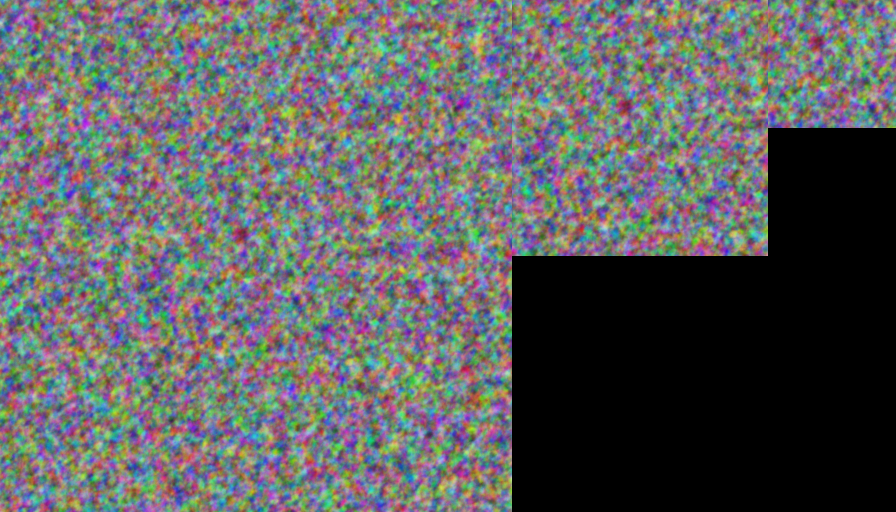

Status: : ETR=0:30:13.498867    ETA=0:30:50.509048      T=0:00:37.010181        Progress: 200/10000     RATE=5.40/s

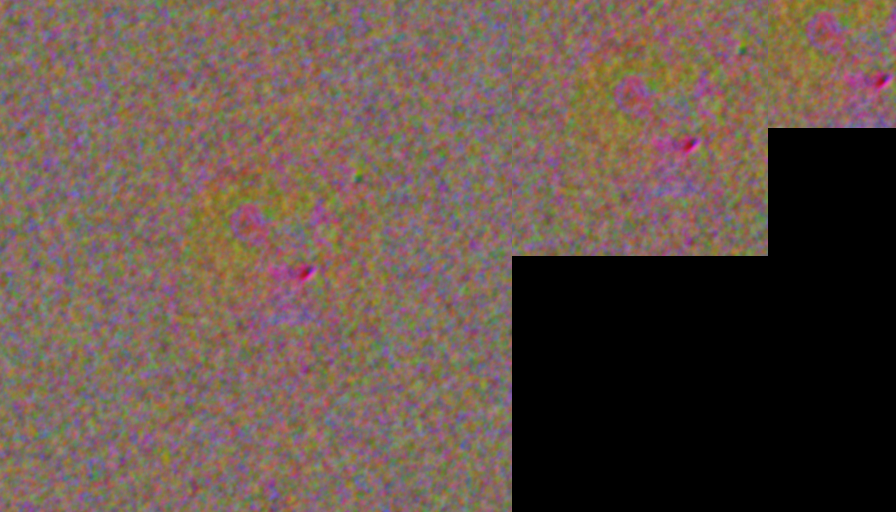

Status: : ETR=0:29:38.672029    ETA=0:30:52.783364      T=0:01:14.111335        Progress: 400/10000     RATE=5.40/s

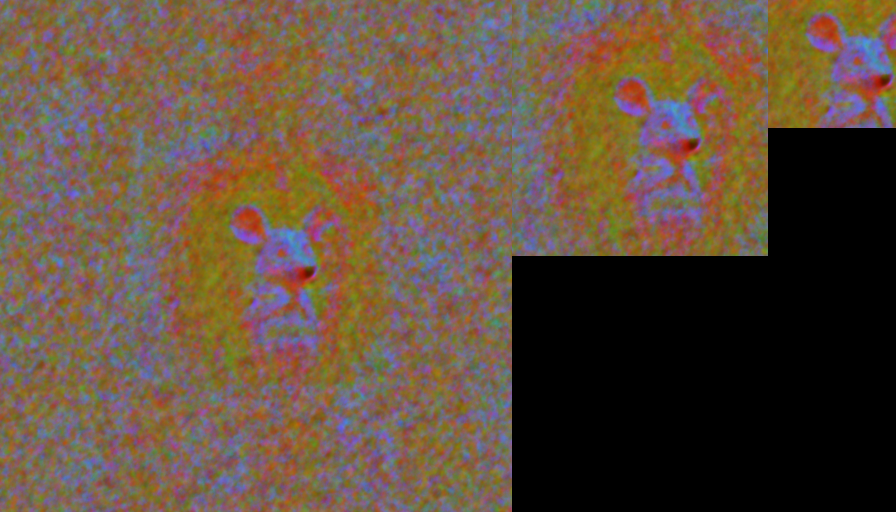

Status: : ETR=0:29:02.501186    ETA=0:30:53.724666      T=0:01:51.223480        Progress: 600/10000     RATE=5.39/s

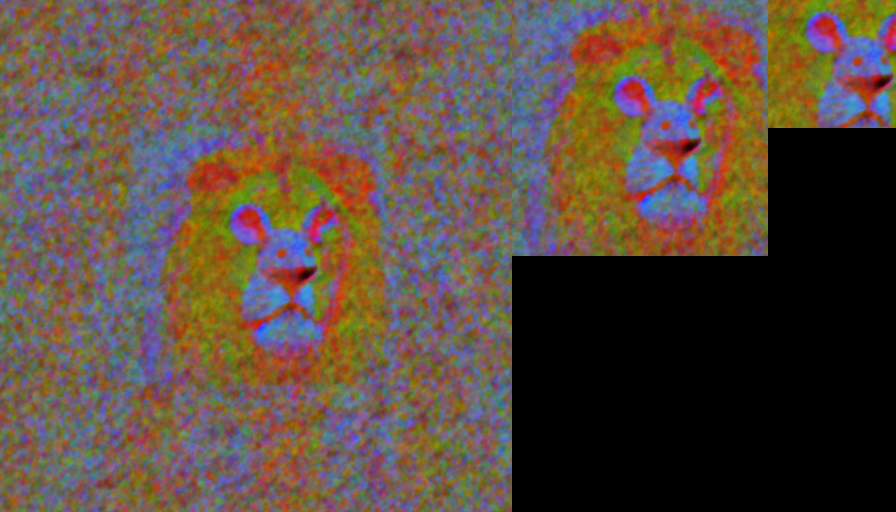

Status: : ETR=0:28:26.014029    ETA=0:30:54.363075      T=0:02:28.349046        Progress: 800/10000     RATE=5.39/s

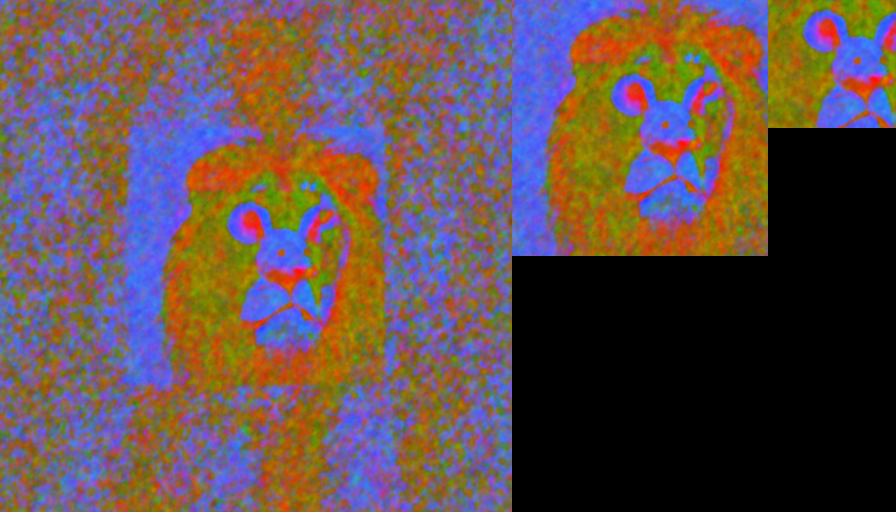

Status: : ETR=0:27:49.447759    ETA=0:30:54.941955      T=0:03:05.494195        Progress: 1000/10000    RATE=5.39/s

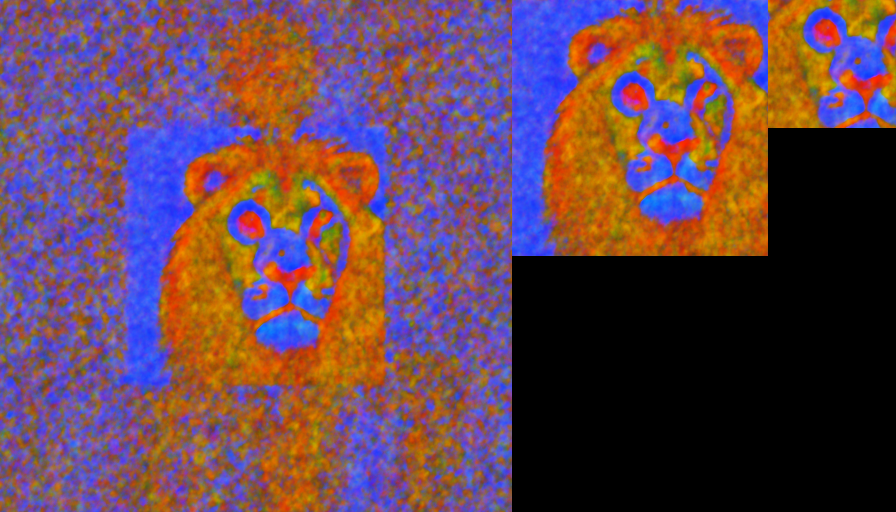

Status: : ETR=0:27:12.538436    ETA=0:30:55.157314      T=0:03:42.618878        Progress: 1200/10000    RATE=5.39/s

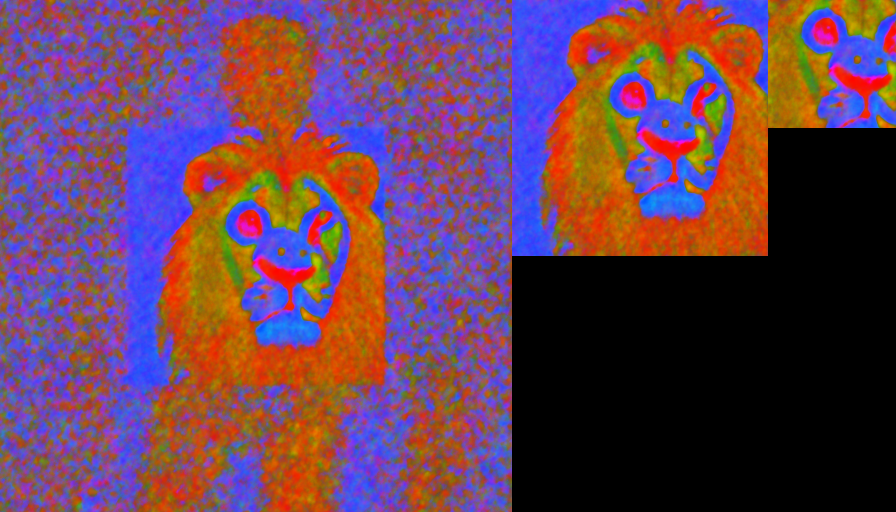

Status: : ETR=0:26:35.584474    ETA=0:30:55.330784      T=0:04:19.746310        Progress: 1400/10000    RATE=5.39/s

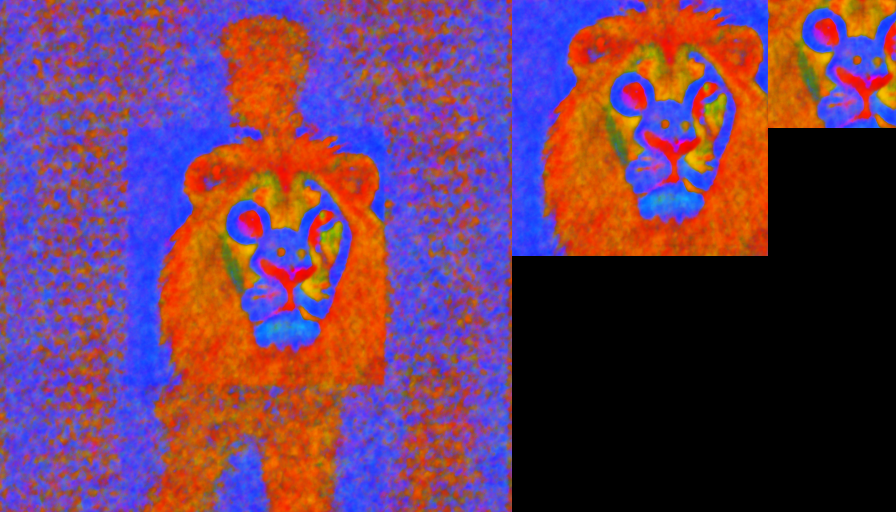

Status: : ETR=0:25:58.598197    ETA=0:30:55.474044      T=0:04:56.875847        Progress: 1600/10000    RATE=5.39/s

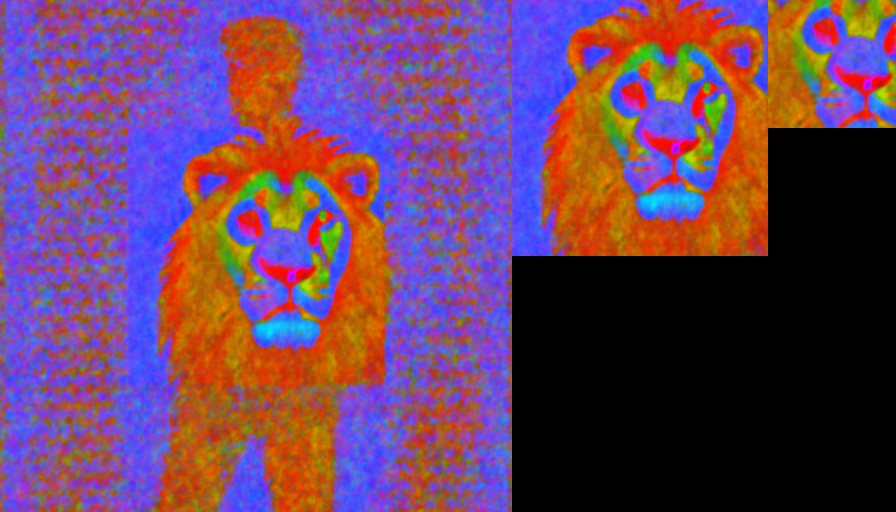

Status: : ETR=0:25:21.603527    ETA=0:30:55.614057      T=0:05:34.010530        Progress: 1800/10000    RATE=5.39/s

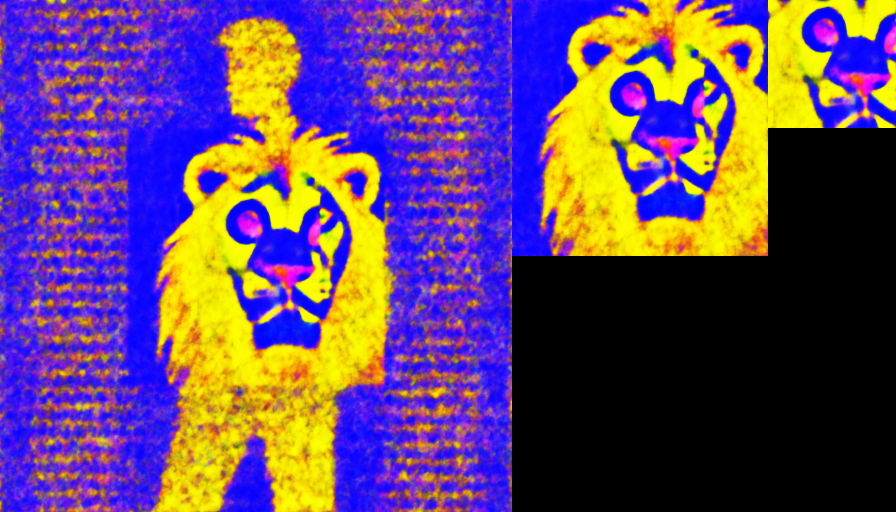

Status: : ETR=0:24:44.550963    ETA=0:30:55.688704      T=0:06:11.137741        Progress: 2000/10000    RATE=5.39/s

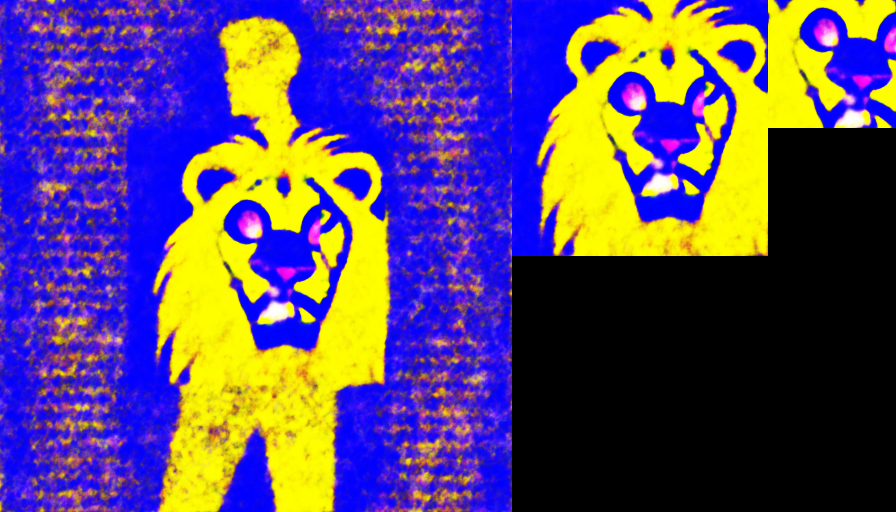

Status: : ETR=0:24:07.444530    ETA=0:30:55.698115      T=0:06:48.253585        Progress: 2200/10000    RATE=5.39/s

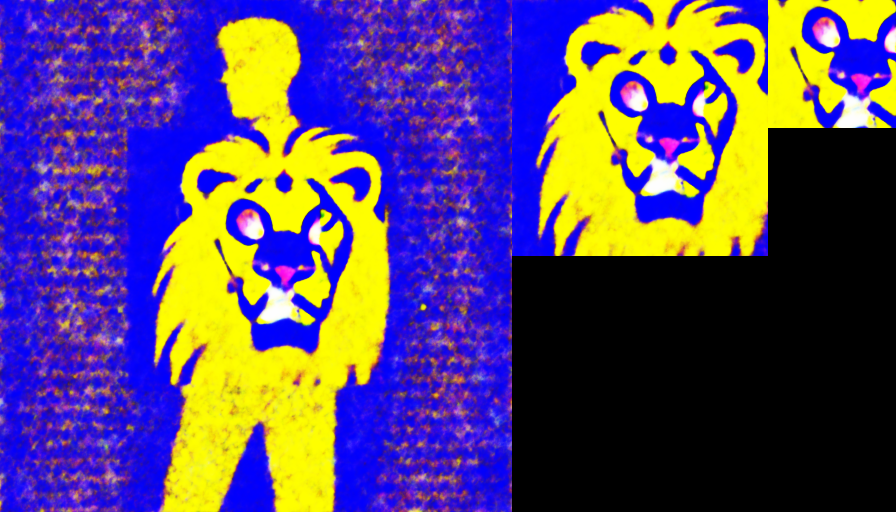

Status: : ETR=0:23:30.355668    ETA=0:30:55.731143      T=0:07:25.375474        Progress: 2400/10000    RATE=5.39/s

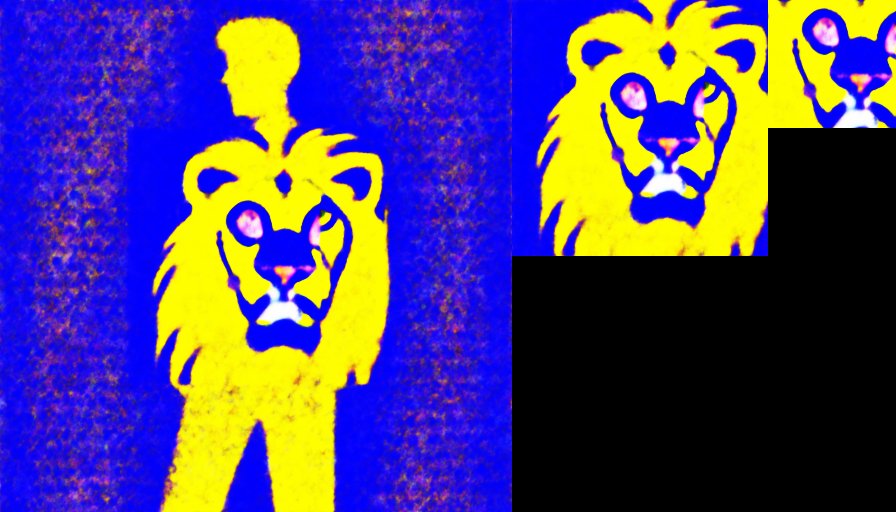

Status: : ETR=0:22:53.231048    ETA=0:30:55.717632      T=0:08:02.486584        Progress: 2600/10000    RATE=5.39/s

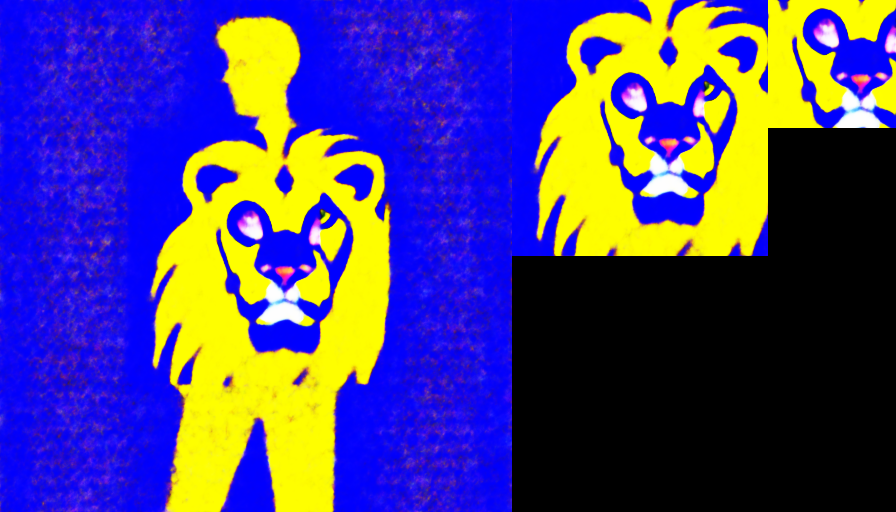

Status: : ETR=0:22:16.090833    ETA=0:30:55.681712      T=0:08:39.590879        Progress: 2800/10000    RATE=5.39/s

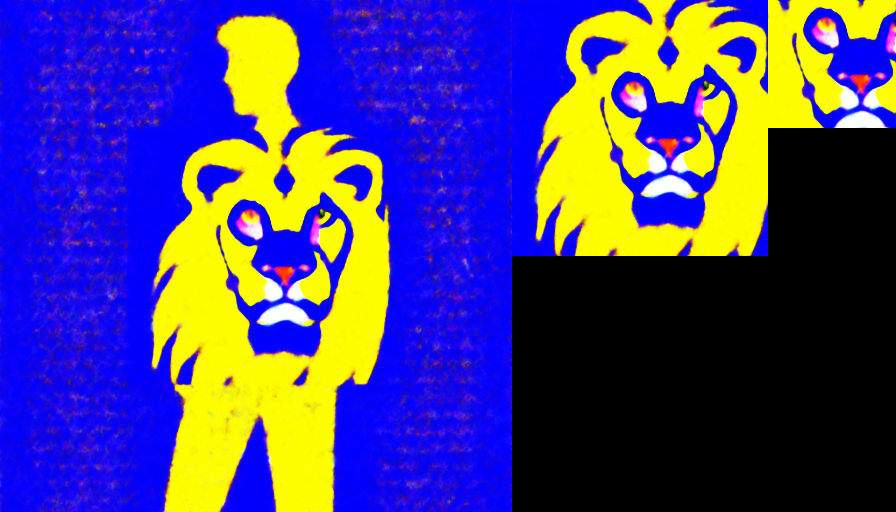

Status: : ETR=0:21:38.950208    ETA=0:30:55.643154      T=0:09:16.692946        Progress: 3000/10000    RATE=5.39/s

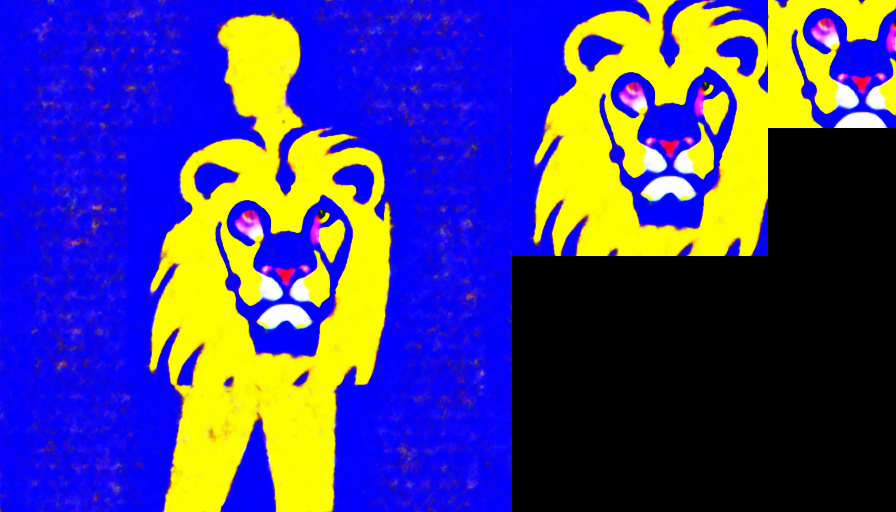

Status: : ETR=0:21:01.818456    ETA=0:30:55.615376      T=0:09:53.796920        Progress: 3200/10000    RATE=5.39/s

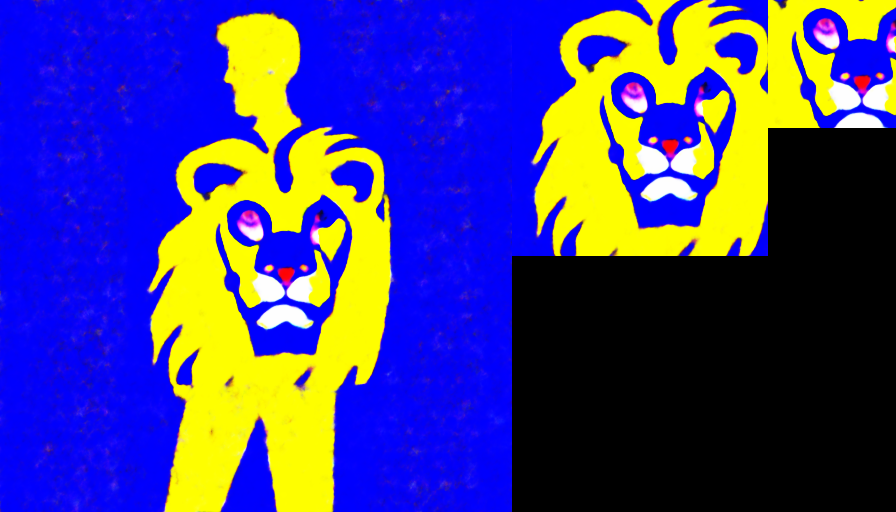

Status: : ETR=0:20:24.686055    ETA=0:30:55.584931      T=0:10:30.898877        Progress: 3400/10000    RATE=5.39/s

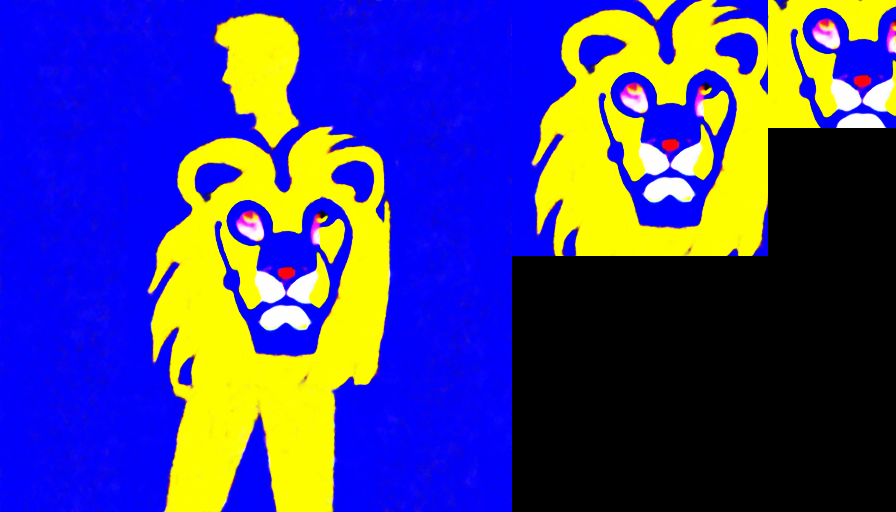

Status: : ETR=0:19:47.532736    ETA=0:30:55.519899      T=0:11:07.987164        Progress: 3600/10000    RATE=5.39/s

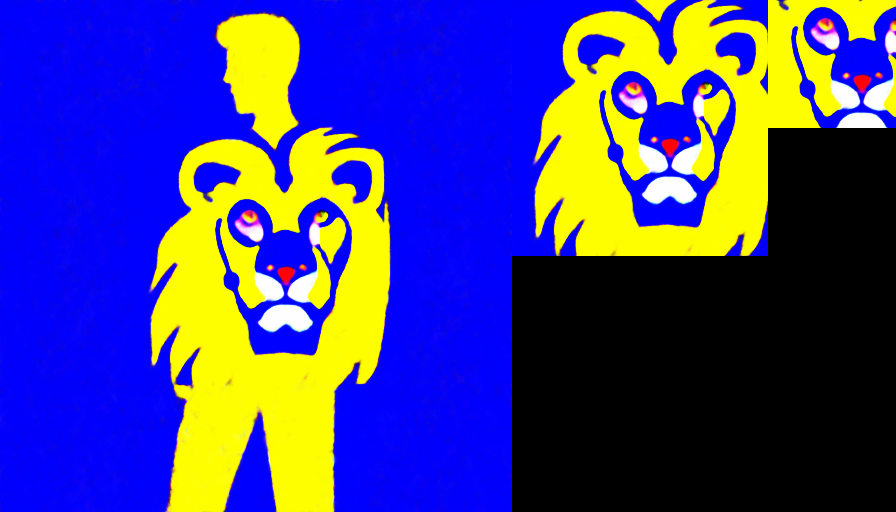

Status: : ETR=0:19:10.396641    ETA=0:30:55.478453      T=0:11:45.081812        Progress: 3800/10000    RATE=5.39/s

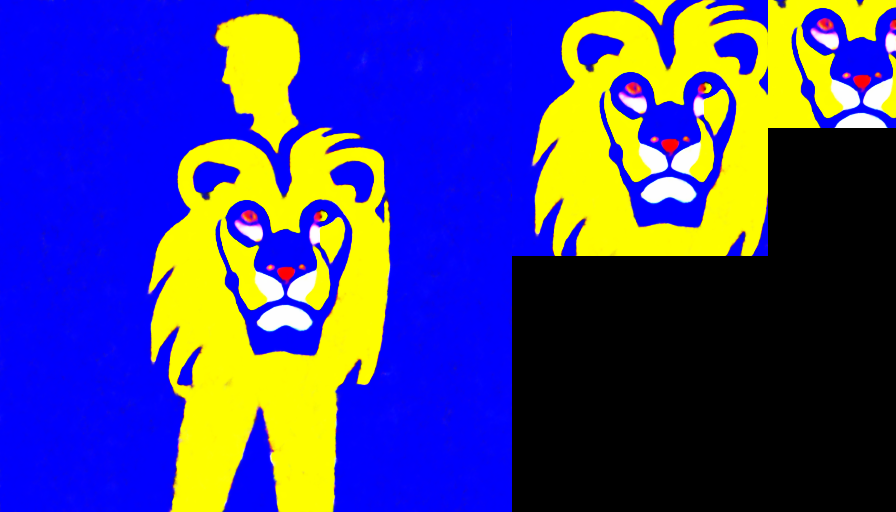

Status: : ETR=0:18:33.259427    ETA=0:30:55.432378      T=0:12:22.172951        Progress: 4000/10000    RATE=5.39/s

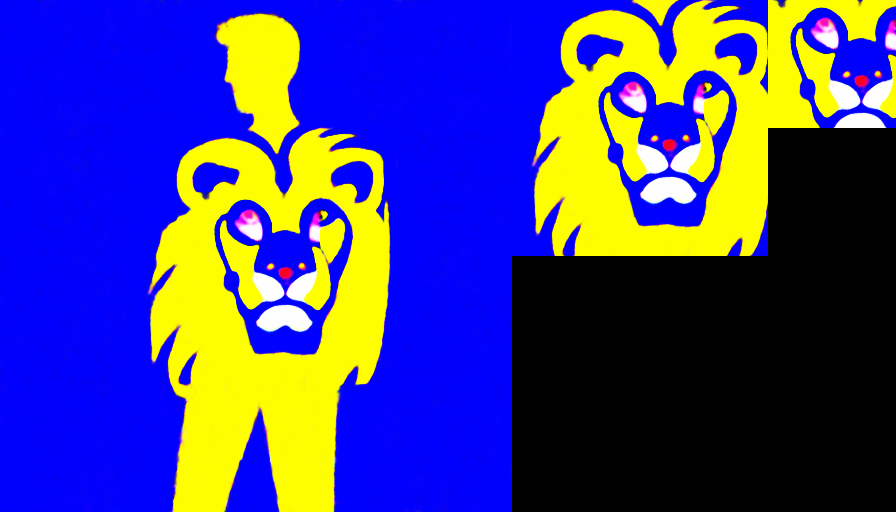

Status: : ETR=0:17:56.121798    ETA=0:30:55.382410      T=0:12:59.260612        Progress: 4200/10000    RATE=5.39/s

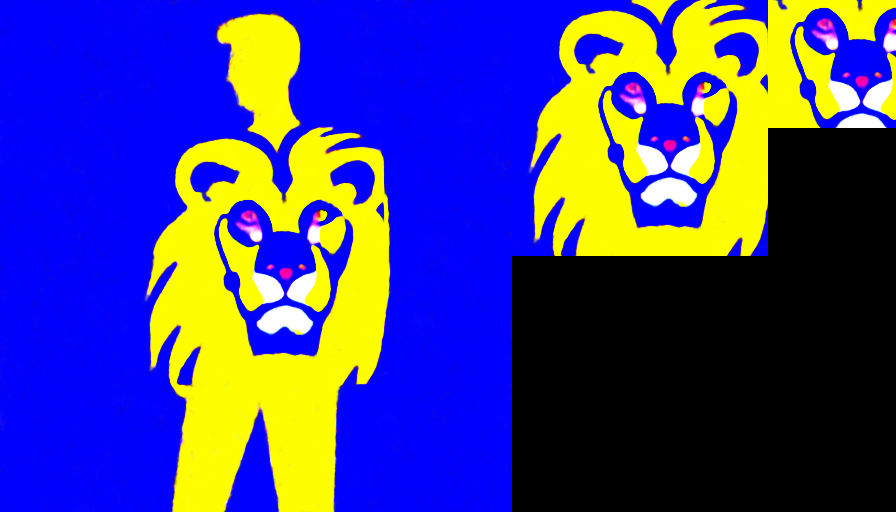

Status: : ETR=0:17:18.999801    ETA=0:30:55.356787      T=0:13:36.356986        Progress: 4400/10000    RATE=5.39/s

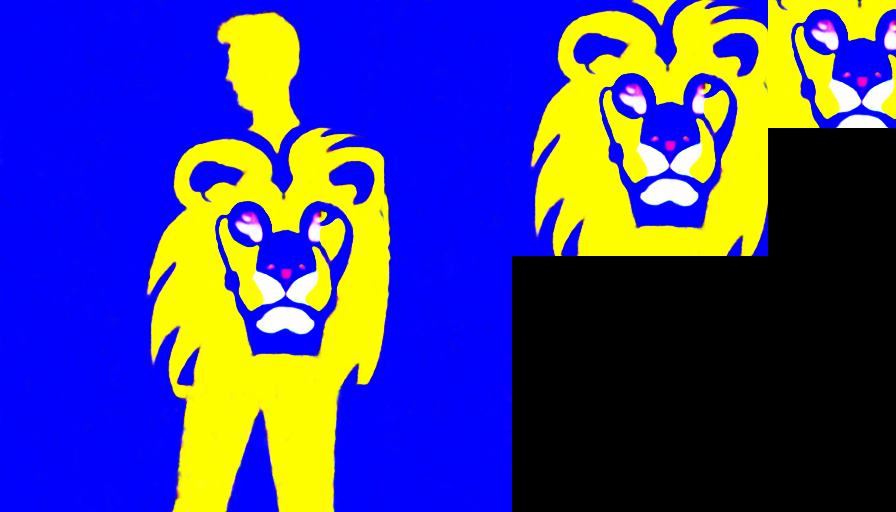

Status: : ETR=0:16:41.885620    ETA=0:30:55.343741      T=0:14:13.458121        Progress: 4600/10000    RATE=5.39/s

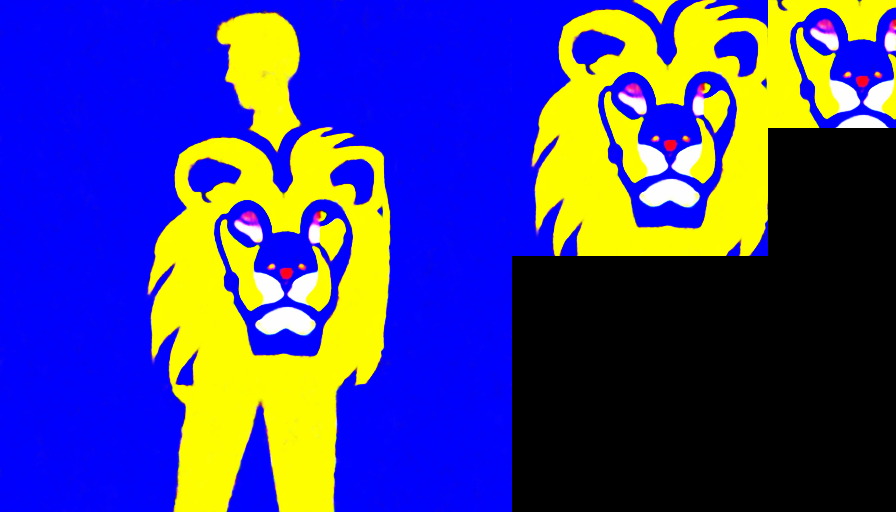

Status: : ETR=0:16:04.756762    ETA=0:30:55.301465      T=0:14:50.544703        Progress: 4800/10000    RATE=5.39/s

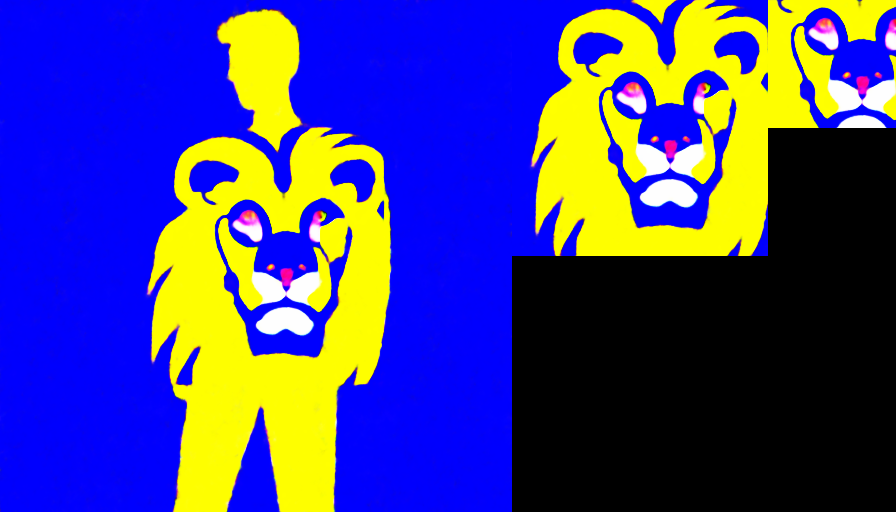

Status: : ETR=0:15:27.615563    ETA=0:30:55.231125      T=0:15:27.615563        Progress: 5000/10000    RATE=5.39/s

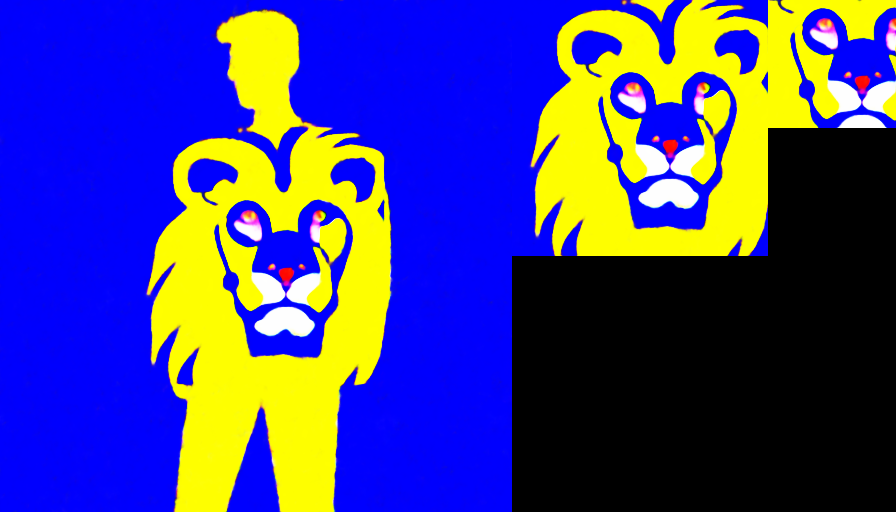

Status: : ETR=0:14:50.473827    ETA=0:30:55.153805      T=0:16:04.679979        Progress: 5200/10000    RATE=5.39/s

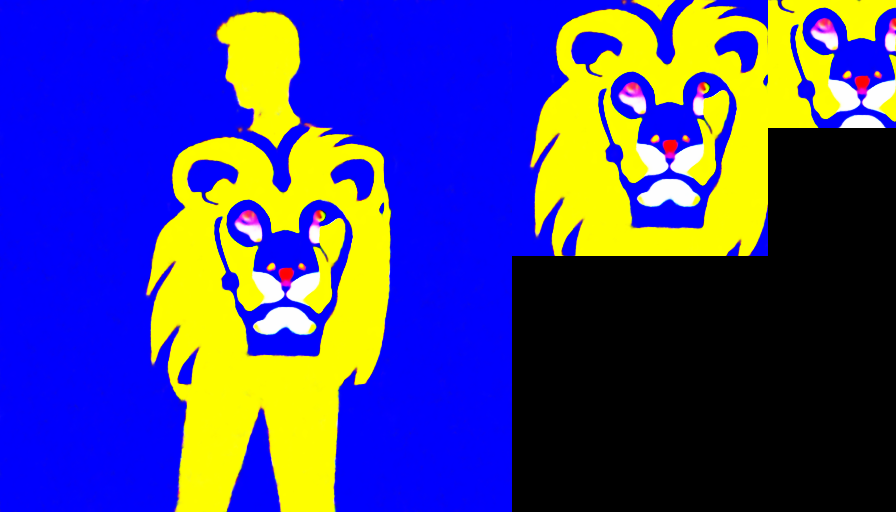

Status: : ETR=0:14:13.325657    ETA=0:30:55.055777      T=0:16:41.730119        Progress: 5400/10000    RATE=5.39/s

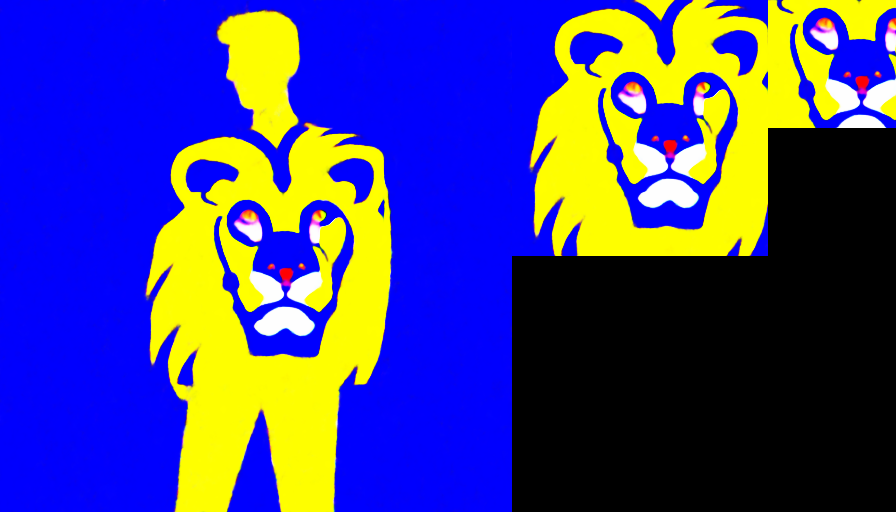

Status: : ETR=0:13:36.201105    ETA=0:30:55.002511      T=0:17:18.801406        Progress: 5600/10000    RATE=5.39/s

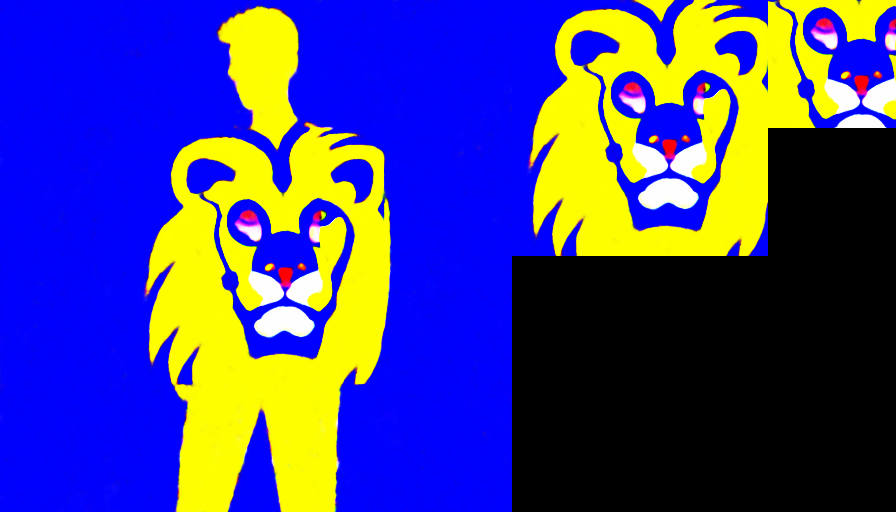

Status: : ETR=0:12:59.084704    ETA=0:30:54.963582      T=0:17:55.878878        Progress: 5800/10000    RATE=5.39/s

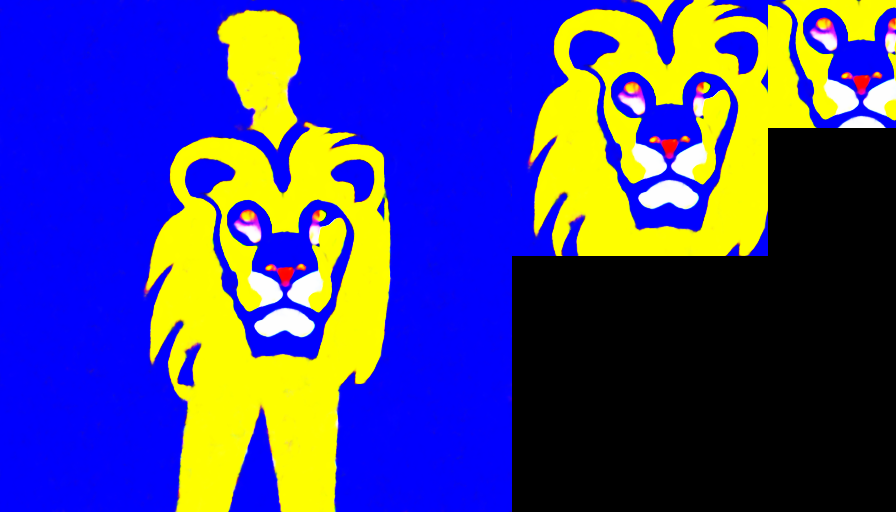

Status: : ETR=0:12:21.965833    ETA=0:30:54.914581      T=0:18:32.948749        Progress: 6000/10000    RATE=5.39/s

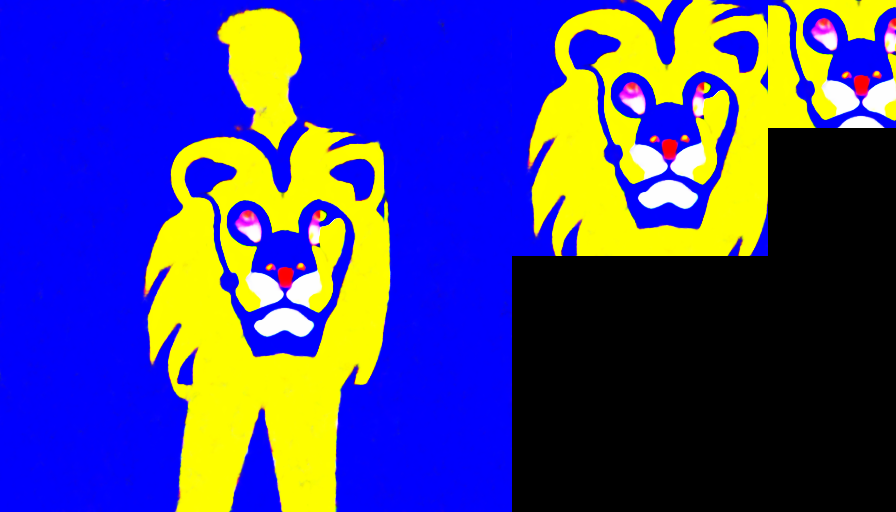

Status: : ETR=0:11:44.856486    ETA=0:30:54.885489      T=0:19:10.029003        Progress: 6200/10000    RATE=5.39/s

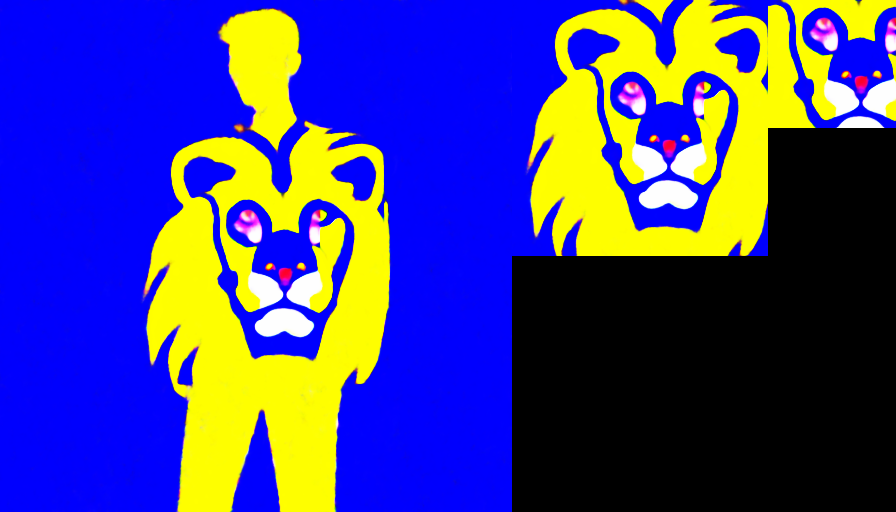

Status: : ETR=0:11:07.738294    ETA=0:30:54.828596      T=0:19:47.090301        Progress: 6400/10000    RATE=5.39/s

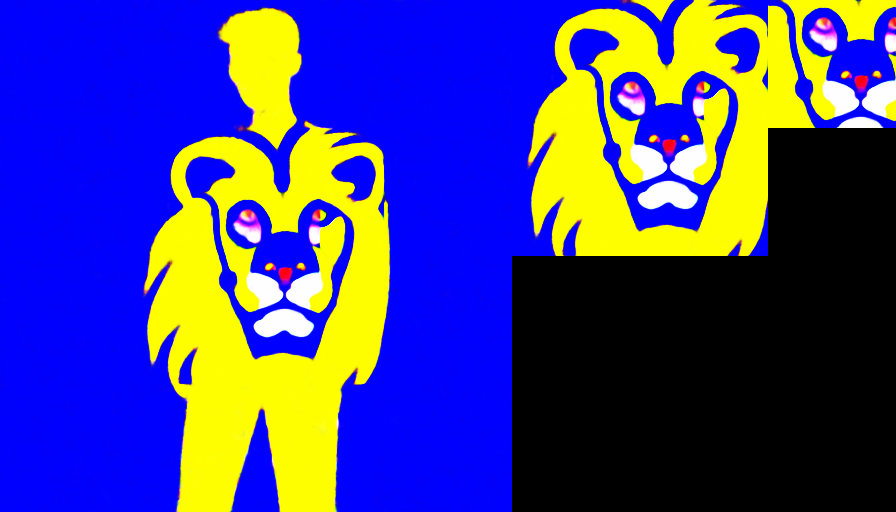

Status: : ETR=0:10:30.630651    ETA=0:30:54.796033      T=0:20:24.165382        Progress: 6600/10000    RATE=5.39/s

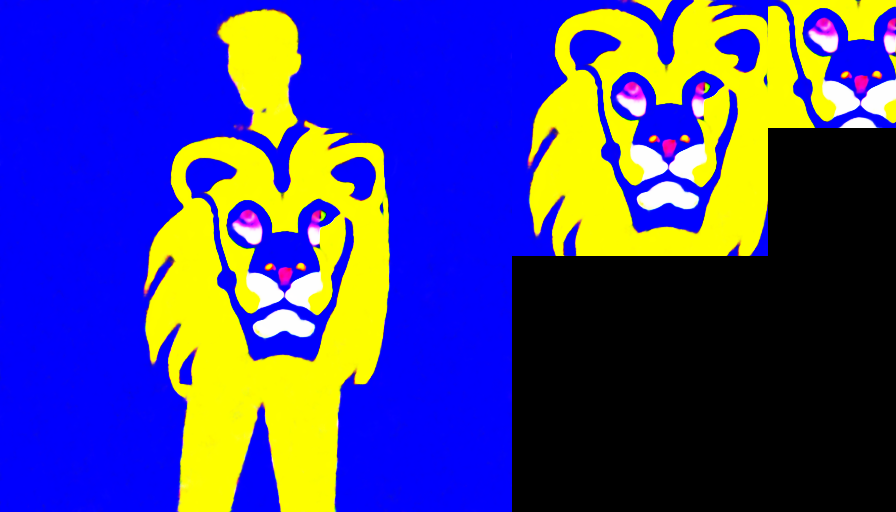

Status: : ETR=0:09:53.527434    ETA=0:30:54.773230      T=0:21:01.245796        Progress: 6800/10000    RATE=5.39/s

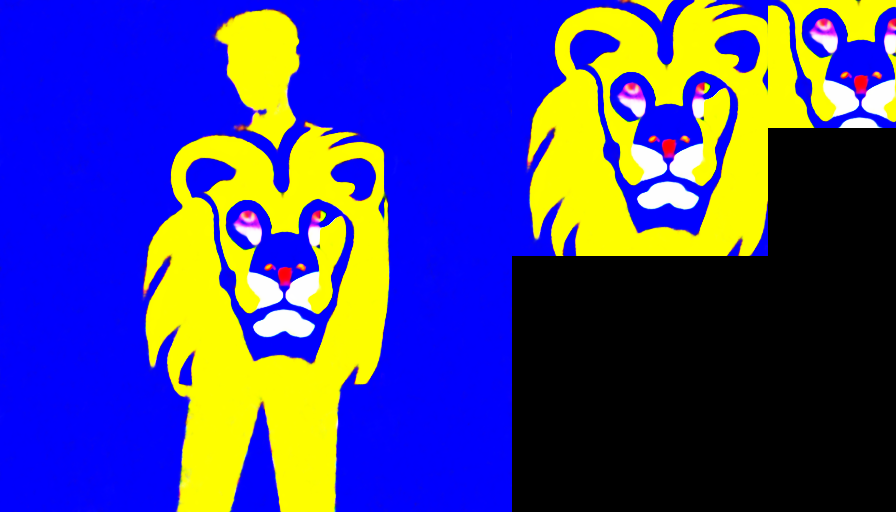

Status: : ETR=0:09:16.421162    ETA=0:30:54.737206      T=0:21:38.316044        Progress: 7000/10000    RATE=5.39/s

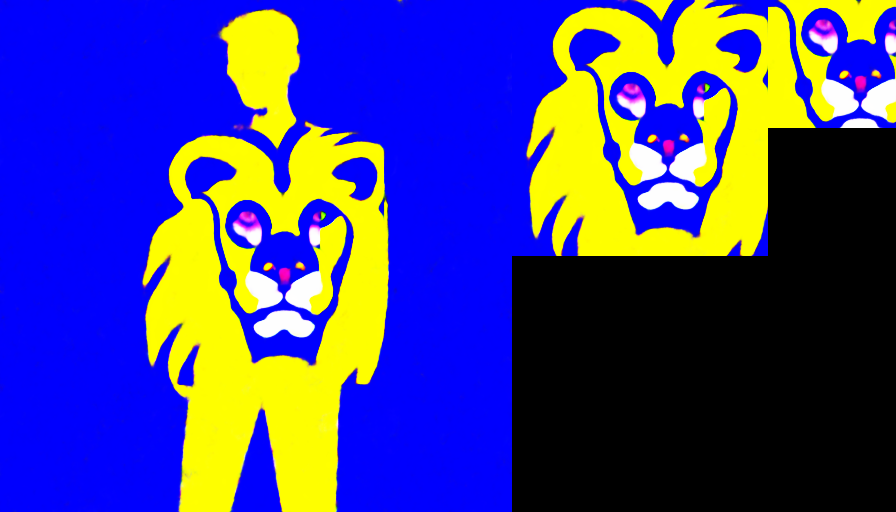

Status: : ETR=0:08:39.316263    ETA=0:30:54.700939      T=0:22:15.384676        Progress: 7200/10000    RATE=5.39/s

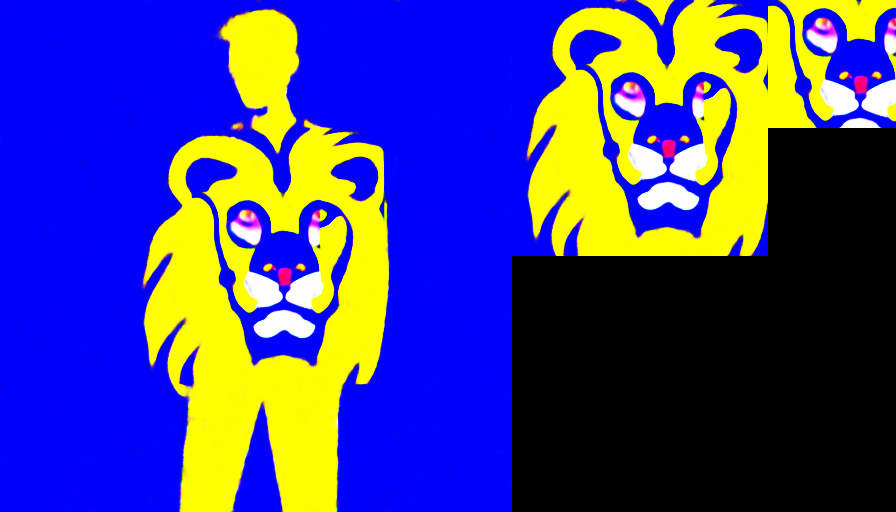

Status: : ETR=0:08:02.216414    ETA=0:30:54.678515      T=0:22:52.462101        Progress: 7400/10000    RATE=5.39/s

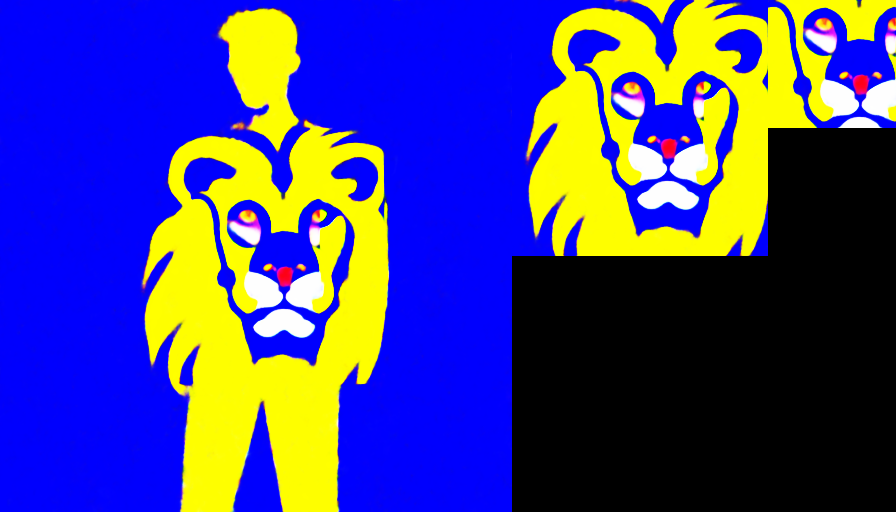

Status: : ETR=0:07:25.123922    ETA=0:30:54.683010      T=0:23:29.559088        Progress: 7600/10000    RATE=5.39/s

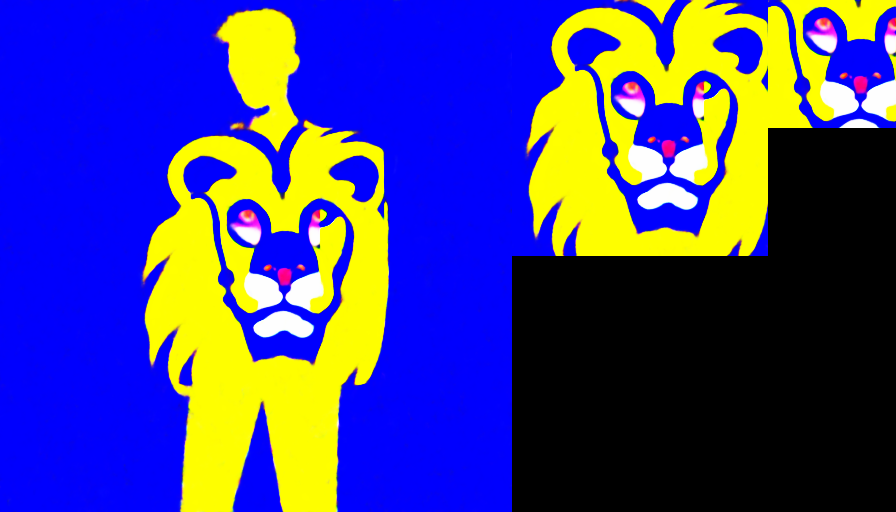

Status: : ETR=0:06:48.024194    ETA=0:30:54.655426      T=0:24:06.631232        Progress: 7800/10000    RATE=5.39/s

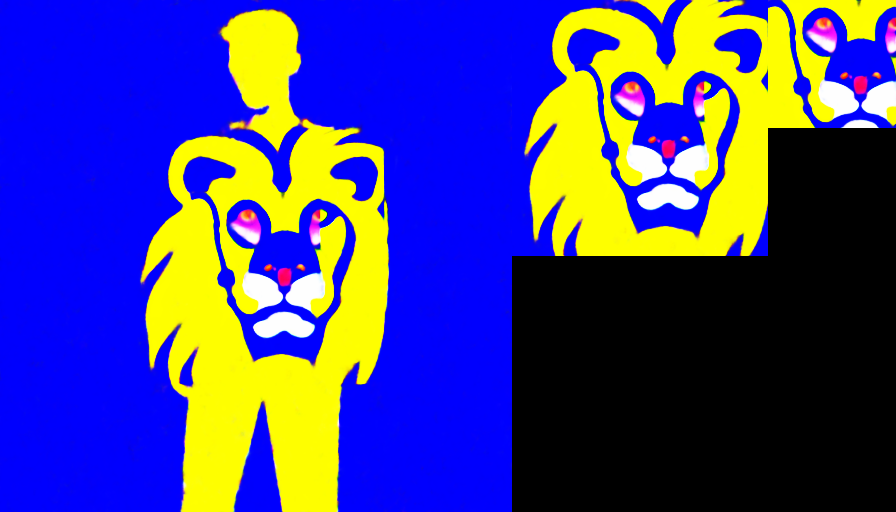

Status: : ETR=0:06:10.923290    ETA=0:30:54.616448      T=0:24:43.693158        Progress: 8000/10000    RATE=5.39/s

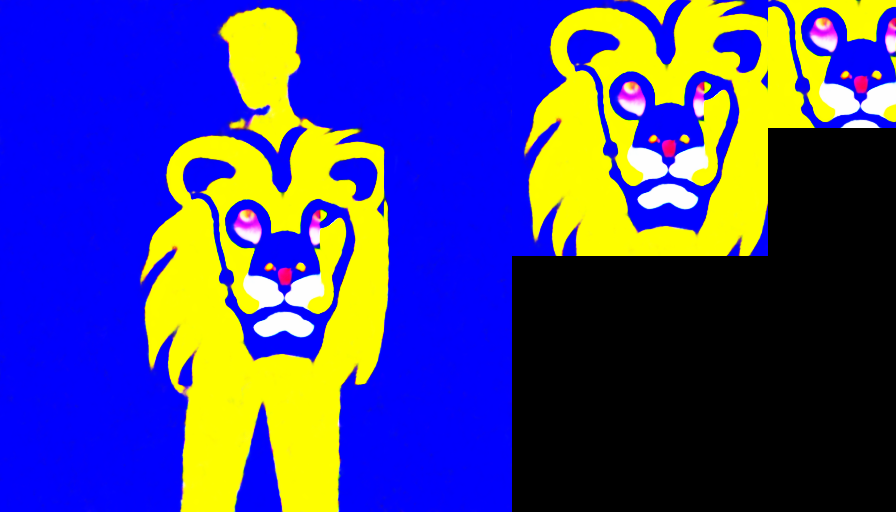

Status: : ETR=0:06:07.231329    ETA=0:30:54.703681      T=0:24:47.472352        Progress: 8020/10000    RATE=5.39/s

In [ ]:
NUM_ITER=10000

#Set the minimum and maximum noise timesteps for the dream loss (aka score distillation loss)
s.max_step=MAX_STEP=990
s.min_step=MIN_STEP=10 

display_eta=rp.eta(NUM_ITER, title='Status: ')

DISPLAY_INTERVAL = 200

print('Every %i iterations we display an image in the form [[image_a, image_b, image_c]] where'%DISPLAY_INTERVAL)
print()
print('Interrupt the kernel at any time to return the currently displayed image')
print('You can run this cell again to resume training later on')
print()
print('Please expect this to take hours to get good images (especially on the slower Colab GPU\'s! The longer you wait the better they\'ll be')

try:
    for iter_num in range(NUM_ITER):
        display_eta(iter_num) #Print the remaining time

        preds=[]
        for label,learnable_image,weight in rp.random_batch(list(zip(labels,learnable_images,weights)), batch_size=1):
            pred=s.train_step(
                label.embedding,
                learnable_image()[None],

                #PRESETS (uncomment one):
                #noise_coef=.1*weight,guidance_scale=60,#10
                # noise_coef=0,image_coef=-.01,guidance_scale=50,
                # noise_coef=0,image_coef=-.005,guidance_scale=50,
                # noise_coef=.1,image_coef=-.010,guidance_scale=50,
                # noise_coef=.1,image_coef=-.005,guidance_scale=50,
                noise_coef=.1*weight, image_coef=-.005*weight, guidance_scale=50,
            )
            preds+=list(pred)

        with torch.no_grad():
            if iter_num and not iter_num%(DISPLAY_INTERVAL*50):
                #Wipe the slate every 50 displays so they don't get cut off
                from IPython.display import clear_output
                clear_output()

            if not iter_num%DISPLAY_INTERVAL:
                im = get_display_image()
                ims.append(im)
                rp.display_image(im)

        optim.step()
        optim.zero_grad()
except KeyboardInterrupt:
    print()
    print('Interrupted early at iteration %i'%iter_num)
    im = get_display_image()
    ims.append(im)
    rp.display_image(im)

In [ ]:
def save_run(name):
    folder="untracked/rotator_multiplier_runs/%s"%name
    if rp.path_exists(folder):
        folder+='_%i'%time.time()
    rp.make_directory(folder)
    ims_names=['ims_%04i.png'%i for i in range(len(ims))]
    with rp.SetCurrentDirectoryTemporarily(folder):
        rp.save_images(ims,ims_names,show_progress=True)
    print()
    print('Saved timelapse to folder:',repr(folder))
    
save_run('untitled') #You can give it a good custom name if you want!